1.MSSV: 20520435

2.Họ tên: Nguyễn Duy Đạt

3.Bài tập: 5

4.Ngày thực hiện: 18/11/2022

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [155]:
! pip install ipyplot -q

import cv2
import glob
import ipyplot
import warnings
import skimage.io
import numpy as np
import pandas as pd
import scipy.spatial.distance
from scipy import fft

warnings.filterwarnings('ignore')

In [ ]:
%cd "/content/drive/MyDrive/CS331.N11.KHTN/Baitap/Baitap5/CIR/"

/content/drive/.shortcut-targets-by-id/1lwaNWZ8gZAvJd-lrt6fh9lyMSVWP7S9g/CS331.N11.KHTN/Baitap/Baitap5/CIR


In [ ]:
images_n = 200
features_n = 20 
image_similarity_measure = scipy.spatial.distance.euclidean 

db_images = pd.DataFrame([{'path': path,
                        'hist': cv2.calcHist([cv2.imread(path)], [0], None, [256], [0, 256])}
                       for path in glob.glob('../CIR/database/*.jpg')[:images_n]])

db_images['feature'] = fft.dct([[image_similarity_measure(x, y) for x in db_images['hist']] for y in db_images['hist']], n=features_n).tolist()
db_images.head(5)

,path,hist,feature
0,../CIR/database/accordion_08.jpg,"[[14165.0], [407.0], [496.0], [539.0], [638.0]...","[378843.12451171875, -92000.78412647158, -65.2..."
1,../CIR/database/accordion_09.jpg,"[[21538.0], [1057.0], [1097.0], [878.0], [900....","[616437.193359375, -103202.98221750319, -25484..."
2,../CIR/database/accordion_01.jpg,"[[12540.0], [89.0], [123.0], [115.0], [100.0],...","[403487.31298828125, -76205.89412589335, 3220...."
3,../CIR/database/accordion_05.jpg,"[[14577.0], [363.0], [755.0], [434.0], [706.0]...","[400270.66748046875, -100718.15373654531, 1214..."
4,../CIR/database/accordion_06.jpg,"[[19640.0], [1848.0], [1354.0], [903.0], [723....","[536131.697265625, -127831.64696944084, -6918...."


In [ ]:
query_images = pd.DataFrame([{'path': path,
                        'hist': cv2.calcHist([cv2.imread(path)], [0], None, [256], [0, 256])}
                       for path in glob.glob('../CIR/query/*.jpg')[:images_n]])

query_images['feature'] = fft.dct([[image_similarity_measure(x, y) for x in query_images['hist']] for y in query_images['hist']], n=features_n).tolist()
query_images.head(5)

,path,hist,feature
0,../CIR/query/accordion_01.jpg,"[[11341.0], [30.0], [514.0], [42.0], [327.0], ...","[394308.3291015625, 87673.04136161861, -160109..."
1,../CIR/query/accordion_02.jpg,"[[11744.0], [128.0], [765.0], [158.0], [496.0]...","[380518.76220703125, 82144.52029523275, -15767..."
2,../CIR/query/accordion_03.jpg,"[[12384.0], [274.0], [199.0], [171.0], [145.0]...","[385925.39013671875, 83854.06474183859, -15734..."
3,../CIR/query/airplane_02.jpg,"[[142.0], [34.0], [63.0], [70.0], [80.0], [97....","[470393.0048828125, 118159.4622752203, -127965..."
4,../CIR/query/airplane_01.jpg,"[[12.0], [3.0], [4.0], [2.0], [5.0], [3.0], [1...","[423676.955078125, 122629.77290620047, -102955..."


Query No. 1



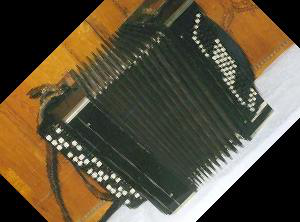


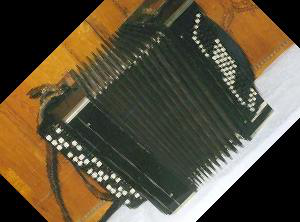


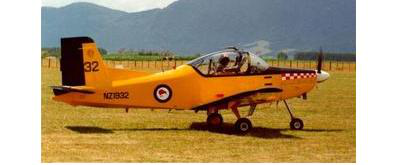
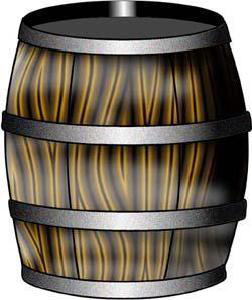
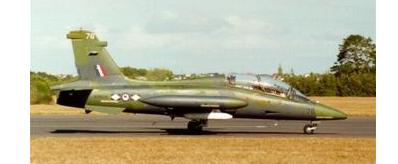
...
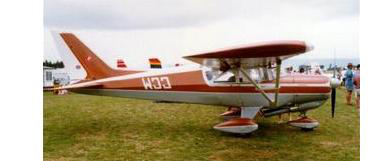
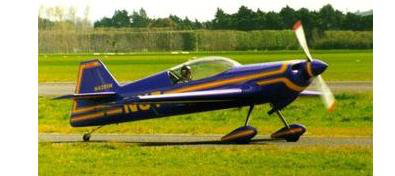
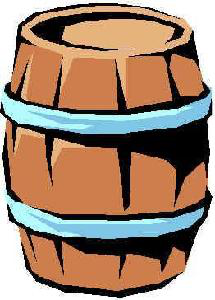
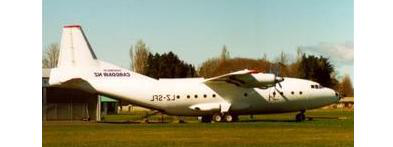
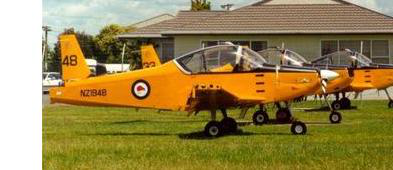

--------------------------------------------------------------------------------------------------------
Query No. 2



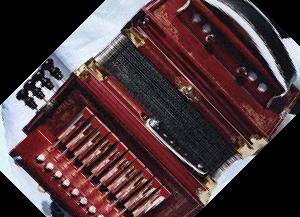


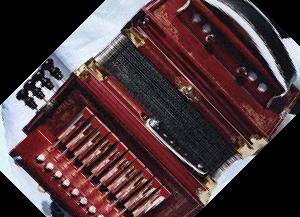


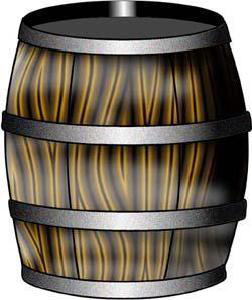
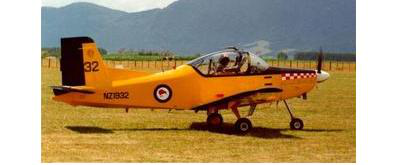
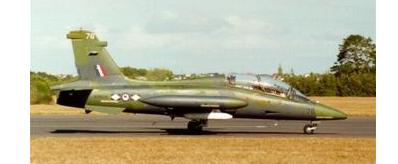
...
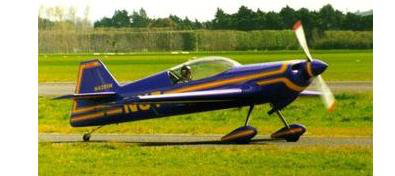
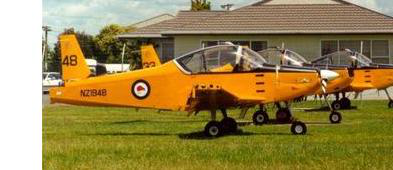
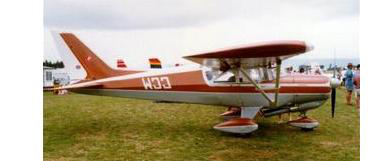
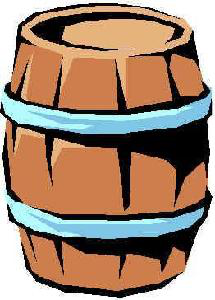
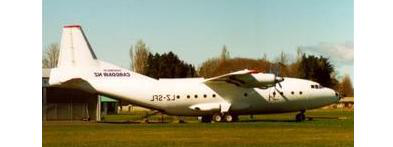

--------------------------------------------------------------------------------------------------------
Query No. 3



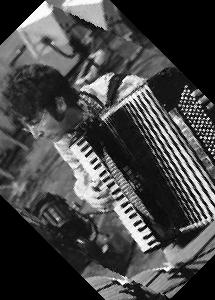


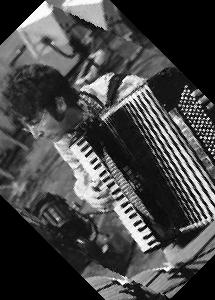


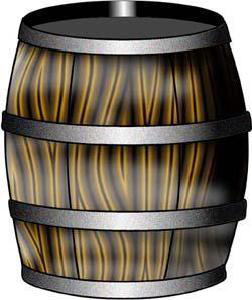
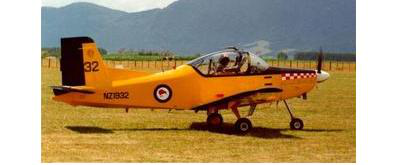
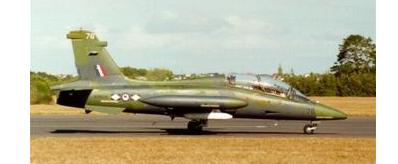
...
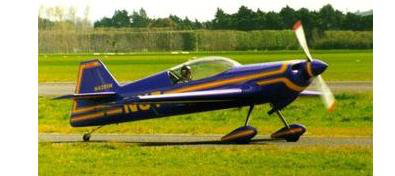
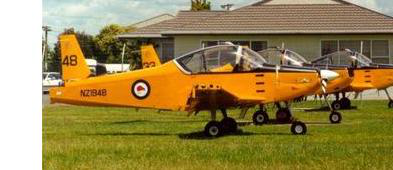
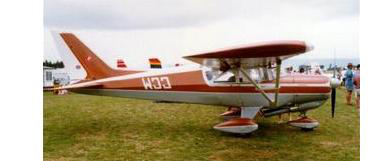
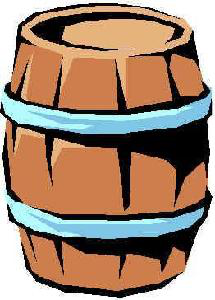
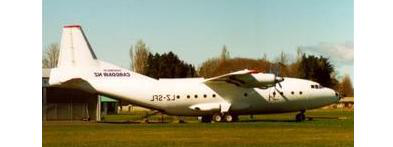

--------------------------------------------------------------------------------------------------------
Query No. 4



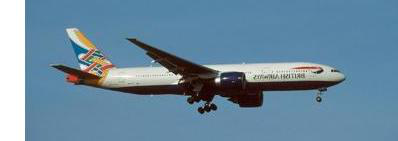


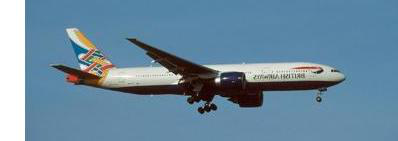


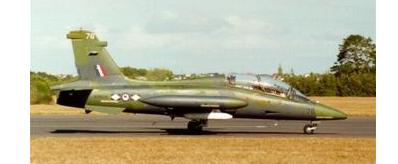
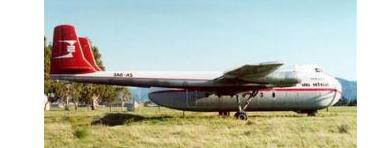
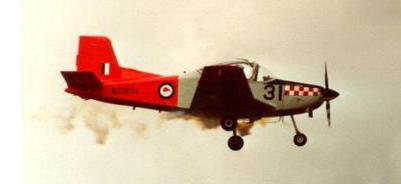
...
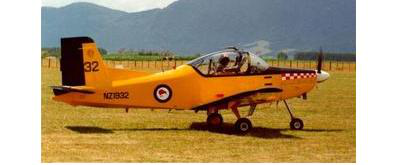
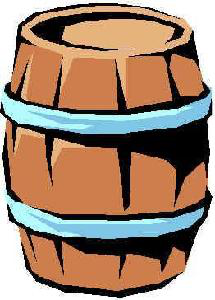
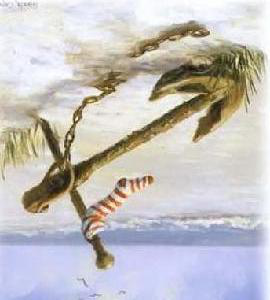
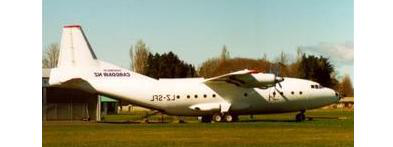
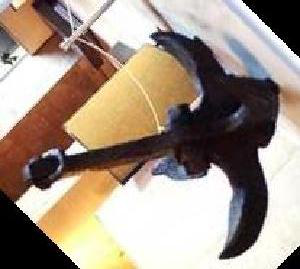

--------------------------------------------------------------------------------------------------------
Query No. 5



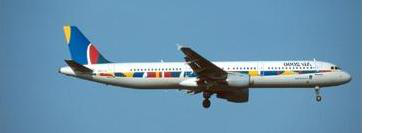


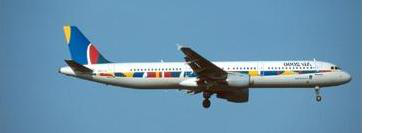


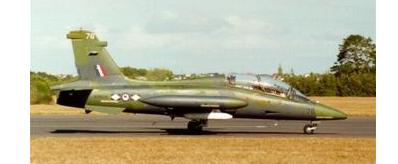
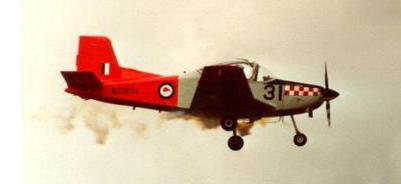
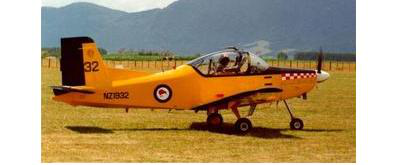
...
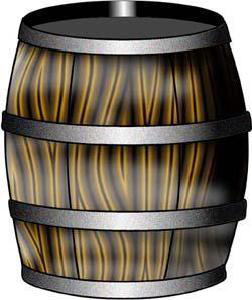
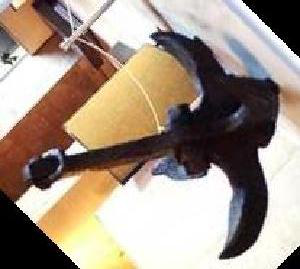
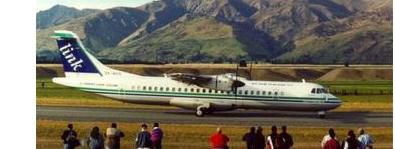
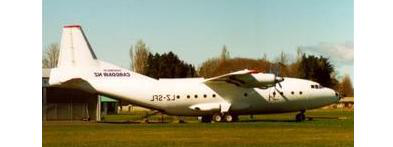
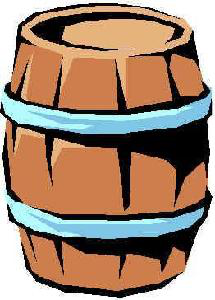

--------------------------------------------------------------------------------------------------------
Query No. 6



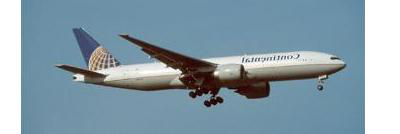


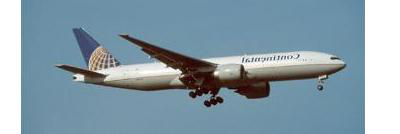


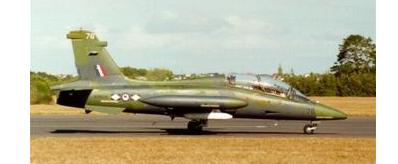
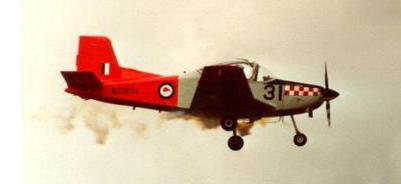
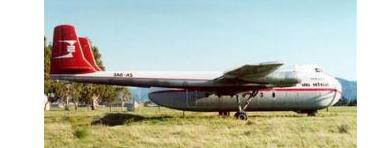
...
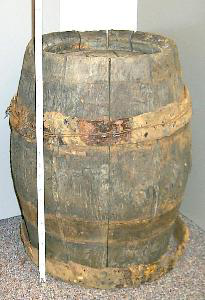
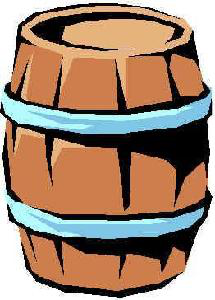
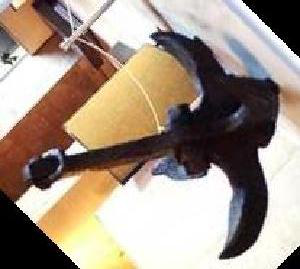
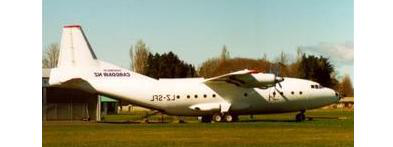
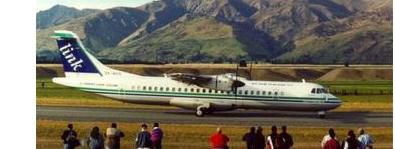

--------------------------------------------------------------------------------------------------------
Query No. 7



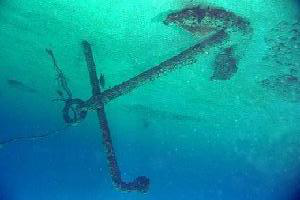


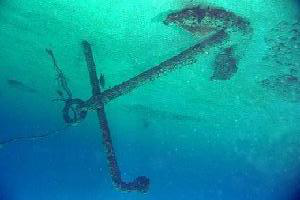


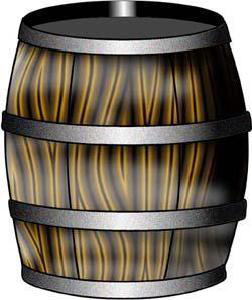
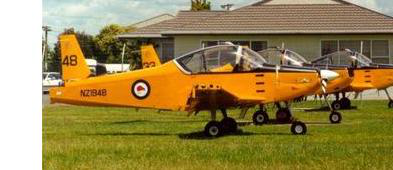
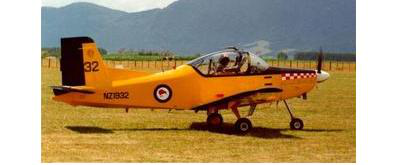
...
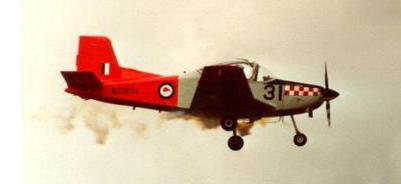
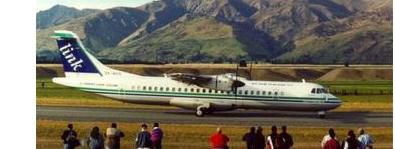
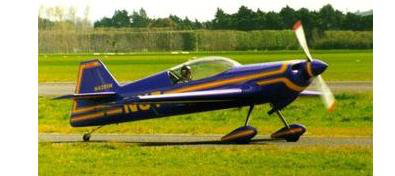
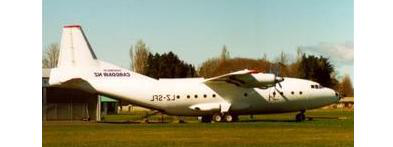
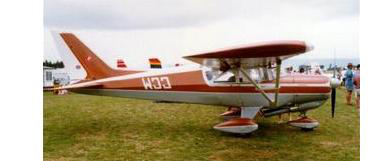

--------------------------------------------------------------------------------------------------------
Query No. 8



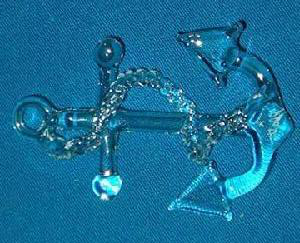


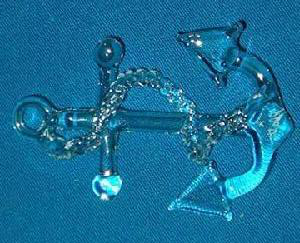


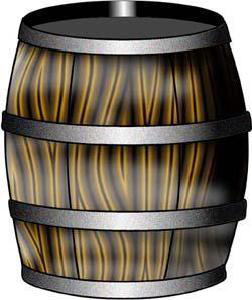
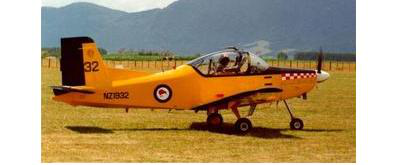
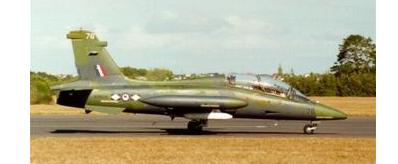
...
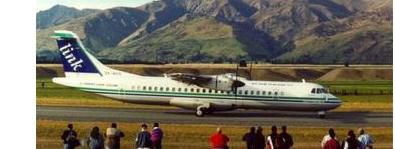
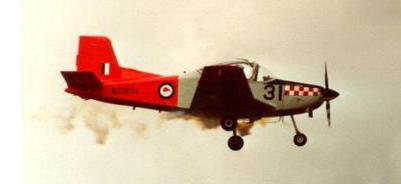
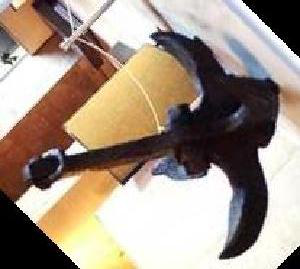
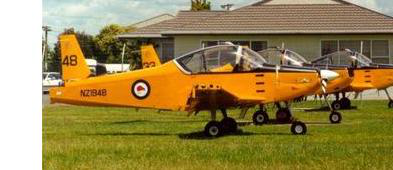
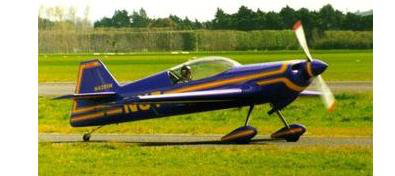

--------------------------------------------------------------------------------------------------------
Query No. 9



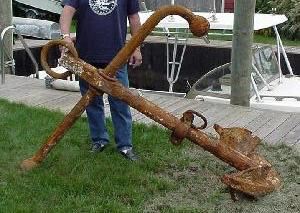


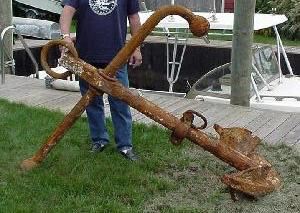


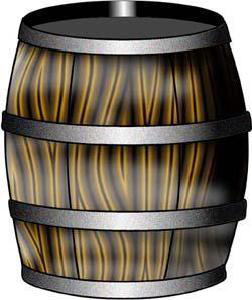
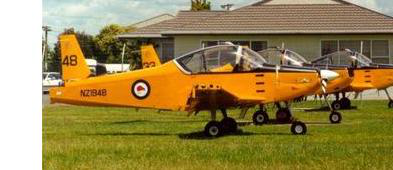
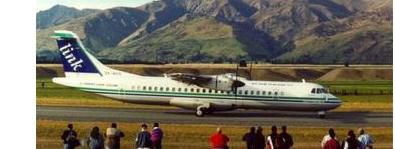
...
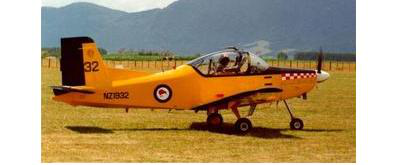
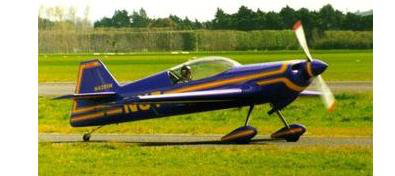
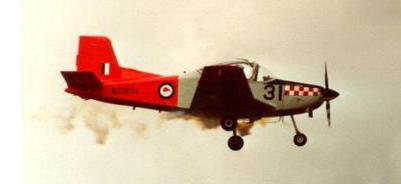
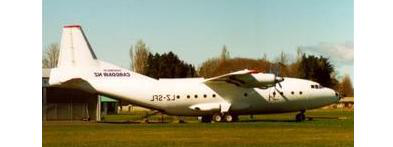
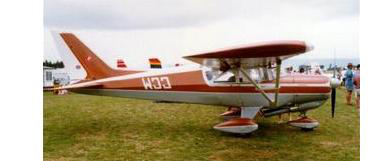

--------------------------------------------------------------------------------------------------------
Query No. 10



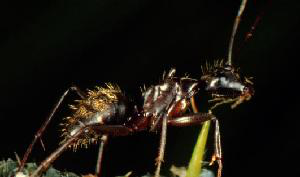


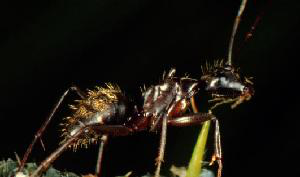


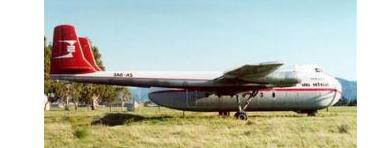
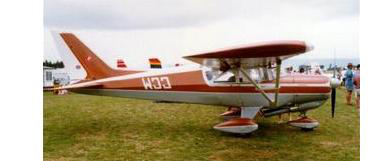
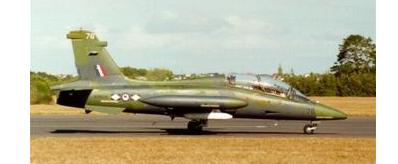
...
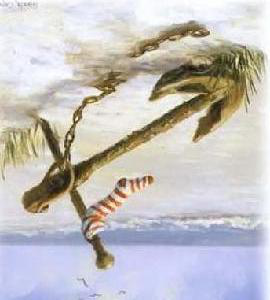
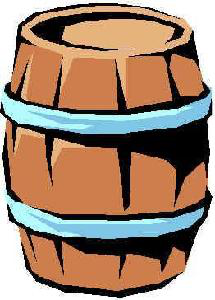
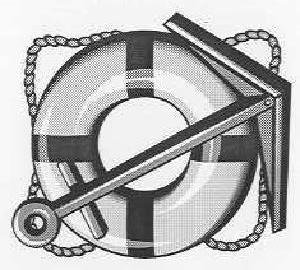
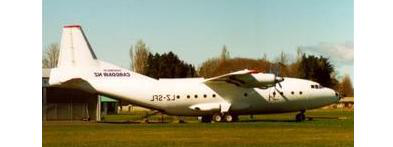
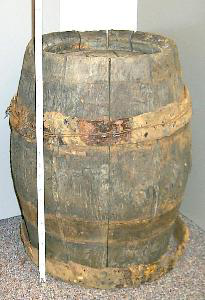

--------------------------------------------------------------------------------------------------------
Query No. 11



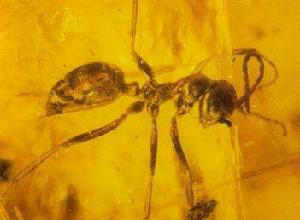


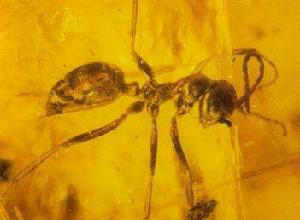


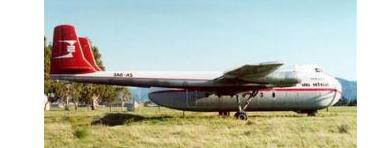
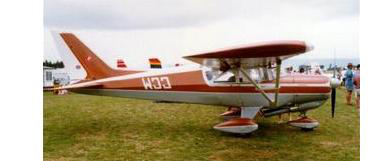
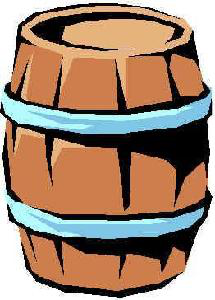
...
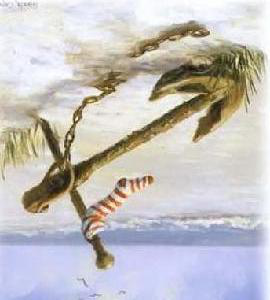
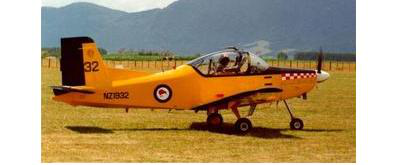
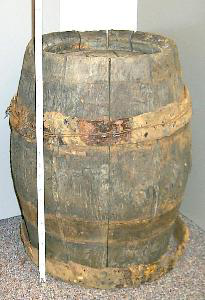
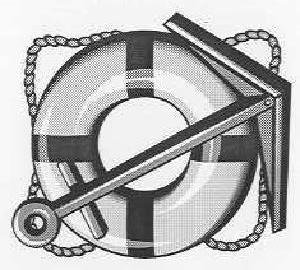
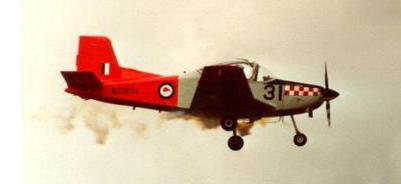

--------------------------------------------------------------------------------------------------------
Query No. 12



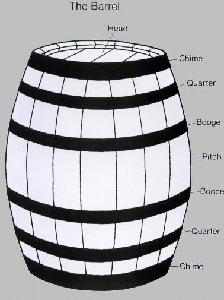


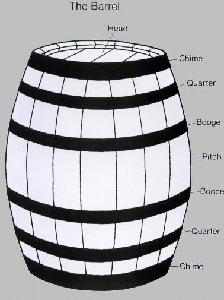


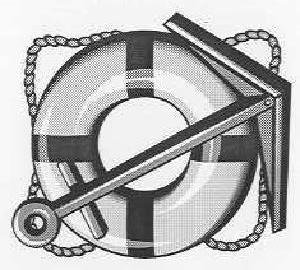
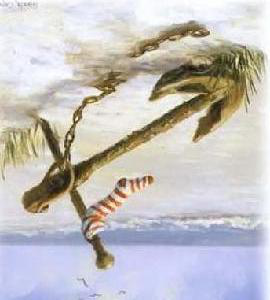
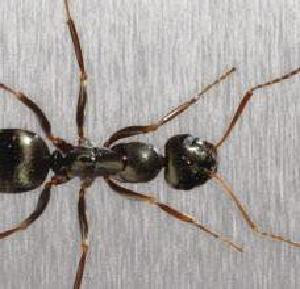
...
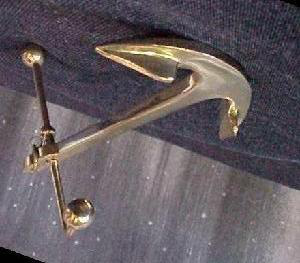
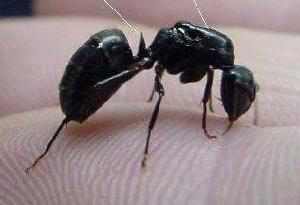
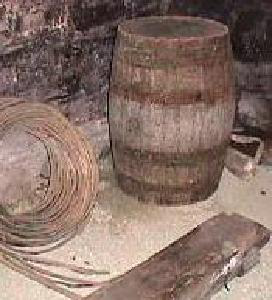
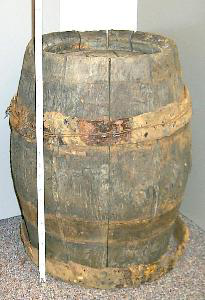
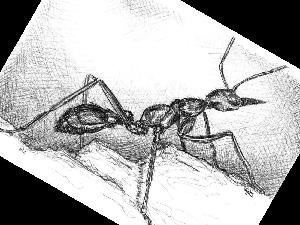

--------------------------------------------------------------------------------------------------------
Query No. 13



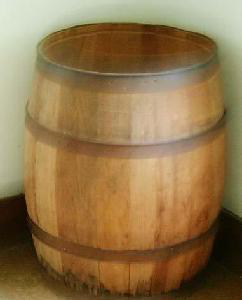


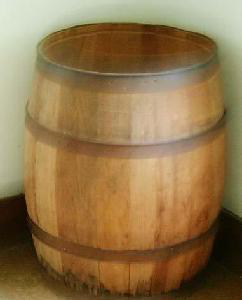


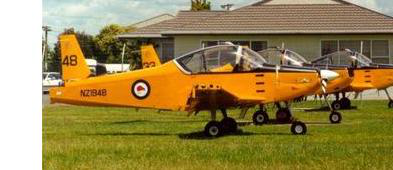
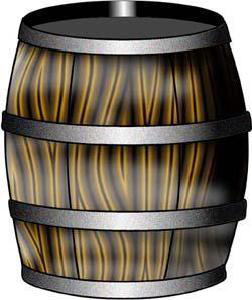
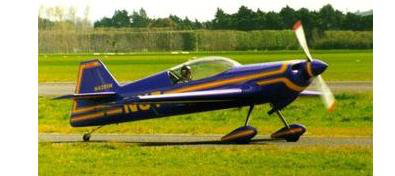
...
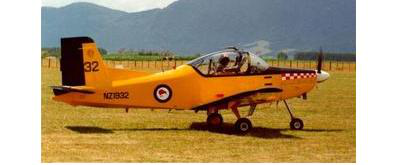
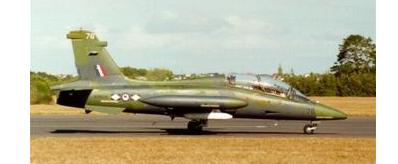
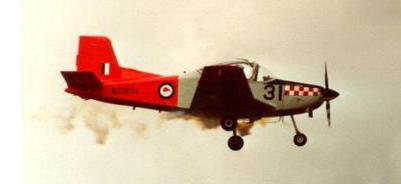
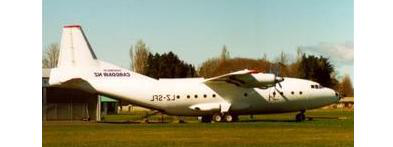
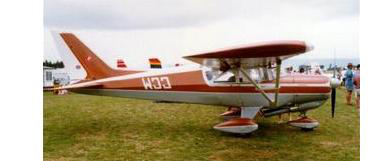

--------------------------------------------------------------------------------------------------------
Query No. 14



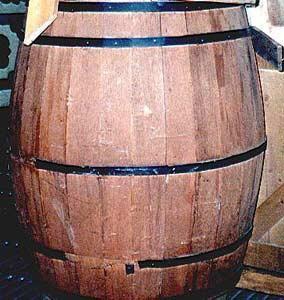


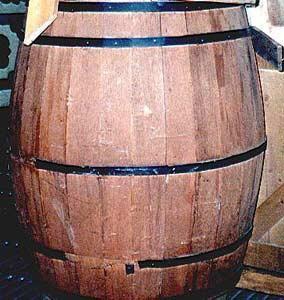


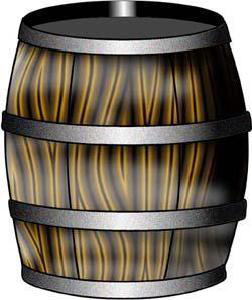
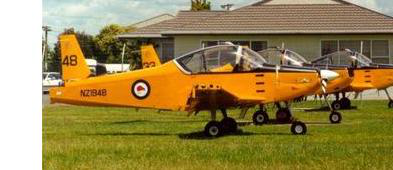
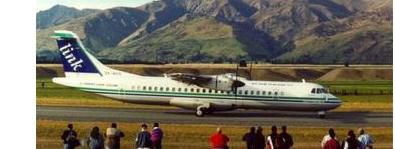
...
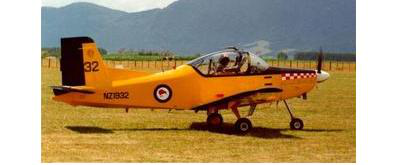
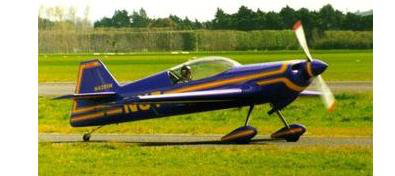
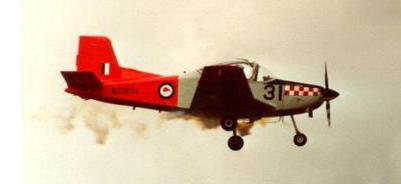
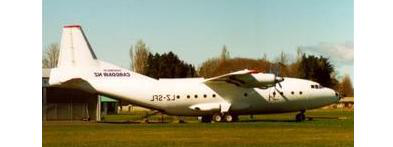
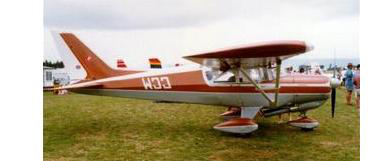

--------------------------------------------------------------------------------------------------------
Query No. 15



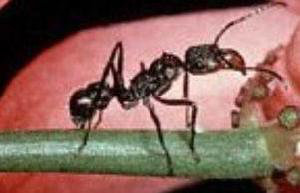


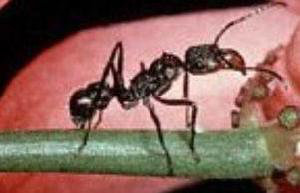


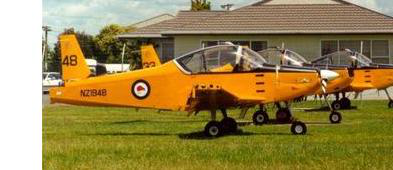
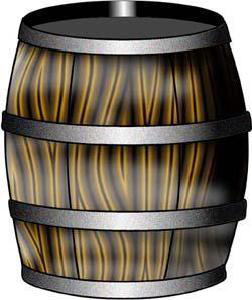
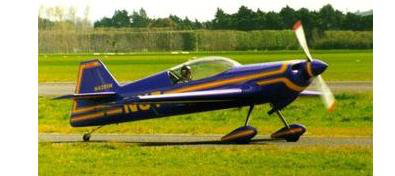
...
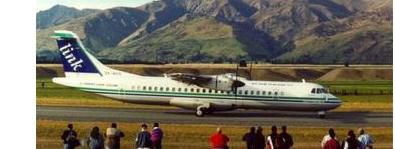
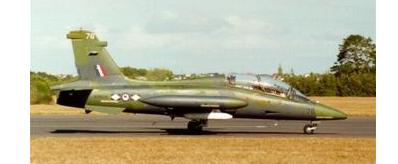
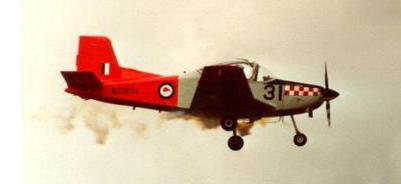
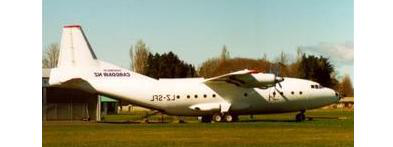
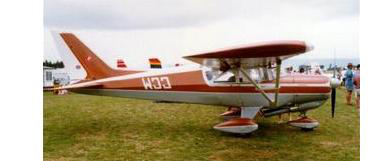

--------------------------------------------------------------------------------------------------------


In [ ]:
feature_similarity_measure = scipy.spatial.distance.euclidean 

results_n = 10 
results = []

for i in range(query_images.shape[0]): #15

  print('Query No.', i+1)
  
  res = db_images.sort_values(by=["feature"], key=lambda features: features.apply(lambda feature: feature_similarity_measure(feature, query_images['feature'][i])))

  ipyplot.plot_images(images=[skimage.io.imread(image_path) for image_path in [query_images['path'][i]]],
                      labels=['Query'], img_width=140, max_images=results_n+1)
  
  ipyplot.plot_images(images=[skimage.io.imread(image_path) for image_path in [*res['path'].tolist()]],
                      labels=[f'Result {i+1}' for i in range(results_n)], img_width=140, max_images=results_n)
  print('--------------------------------------------------------------------------------------------------------')
  
  results.append(res)
  

  # _Calc_MRR(query_images, results)

In [ ]:
for i in range(len(query_images['path'])):
  query_images['path'][i] = query_images['path'][i].replace('../CIR/query/', '')
query_images.head(5)

,path,hist,feature
0,accordion_01.jpg,"[[11341.0], [30.0], [514.0], [42.0], [327.0], ...","[394308.3291015625, 87673.04136161861, -160109..."
1,accordion_02.jpg,"[[11744.0], [128.0], [765.0], [158.0], [496.0]...","[380518.76220703125, 82144.52029523275, -15767..."
2,accordion_03.jpg,"[[12384.0], [274.0], [199.0], [171.0], [145.0]...","[385925.39013671875, 83854.06474183859, -15734..."
3,airplane_02.jpg,"[[142.0], [34.0], [63.0], [70.0], [80.0], [97....","[470393.0048828125, 118159.4622752203, -127965..."
4,airplane_01.jpg,"[[12.0], [3.0], [4.0], [2.0], [5.0], [3.0], [1...","[423676.955078125, 122629.77290620047, -102955..."


In [ ]:
for i in range(15):
  for j in range(50):
    results[i]['path'][j] = results[i]['path'][j].replace('../CIR/database/', '')
results[0].head(5)

,path,hist,feature
19,airplane_03.jpg,"[[4160.0], [516.0], [539.0], [570.0], [534.0],...","[432551.5322265625, 93926.15505700087, 9253.05..."
48,barrel_01.jpg,"[[3711.0], [2328.0], [828.0], [885.0], [734.0]...","[397964.2841796875, 69892.62664500807, 24223.7..."
17,airplane_01.jpg,"[[1564.0], [165.0], [190.0], [175.0], [165.0],...","[449606.6044921875, 105720.32065933826, 9583.1..."
28,anchor_07.jpg,"[[3808.0], [291.0], [326.0], [169.0], [155.0],...","[423291.6142578125, 53333.98239439739, 22221.1..."
18,airplane_02.jpg,"[[2529.0], [599.0], [636.0], [672.0], [612.0],...","[449478.9462890625, 78401.73049908881, 7650.91..."


In [ ]:
for i in range(15):
  for j in range(50):
    results[i]['path'][j] = results[i]['path'][j].split('_')[0]
results[0].head(5)

,path,hist,feature
19,airplane,"[[4160.0], [516.0], [539.0], [570.0], [534.0],...","[432551.5322265625, 93926.15505700087, 9253.05..."
48,barrel,"[[3711.0], [2328.0], [828.0], [885.0], [734.0]...","[397964.2841796875, 69892.62664500807, 24223.7..."
17,airplane,"[[1564.0], [165.0], [190.0], [175.0], [165.0],...","[449606.6044921875, 105720.32065933826, 9583.1..."
28,anchor,"[[3808.0], [291.0], [326.0], [169.0], [155.0],...","[423291.6142578125, 53333.98239439739, 22221.1..."
18,airplane,"[[2529.0], [599.0], [636.0], [672.0], [612.0],...","[449478.9462890625, 78401.73049908881, 7650.91..."


In [ ]:
top_k = 10
sum_rank = []
for i in range(15): # 15 queries
  rank = 0
  for j in range(top_k): # take top 10 of 50 results for per query
    if query_images['path'][i].split('_')[0] == results[i]['path'][j]:
      rank += 1/(j+1)
  sum_rank.append(rank)

In [ ]:
summary = {'Query' : np.array(query_images['path']), 'sum_rank' : sum_rank}
df = pd.DataFrame(data=summary)
print('MRR:', np.mean(sum_rank))
df

MRR: 0.5857936507936508


,Query,sum_rank
0,accordion_01.jpg,2.592857
1,accordion_02.jpg,2.592857
2,accordion_03.jpg,2.592857
3,airplane_02.jpg,0.336111
4,airplane_01.jpg,0.336111
5,airplane_03.jpg,0.336111
6,anchor_04.jpg,0.000000
7,anchor_02.jpg,0.000000
8,anchor_01.jpg,0.000000
9,ant_02.jpg,0.000000
